In [1]:
import pandas as pd 
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
import numpy as np
from sklearn.feature_extraction.text import CountVectorizer,TfidfVectorizer
from sklearn.base import TransformerMixin
from sklearn.pipeline import Pipeline
import string
from sklearn import metrics

import matplotlib.pyplot as plt

import warnings  
warnings.filterwarnings('ignore')

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

In [2]:
%ls

 El volumen de la unidad C es Local Disk
 El número de serie del volumen es: 0671-FAEA

 Directorio de C:\Users\Monica\Proyecto Final Ironhack

13/03/2024  13:34    <DIR>          .
13/03/2024  13:34    <DIR>          ..
13/03/2024  12:17    <DIR>          .ipynb_checkpoints
12/03/2024  14:21        30.308.369 LaLiga.ipynb
13/03/2024  13:20             1.092 LaLiga_Classification.csv
12/03/2024  14:20             2.350 LaLiga_Classification_final.csv
13/03/2024  12:46             2.343 LaLiga_Classification_final_draws.csv
13/03/2024  12:42             2.358 LaLiga_Classification_final_goals_conceded.csv
13/03/2024  12:44             2.356 LaLiga_Classification_final_goals_scored.csv
13/03/2024  12:52             2.343 LaLiga_Classification_final_losses.csv
13/03/2024  12:55             2.341 LaLiga_Classification_final_wins.csv
13/03/2024  12:47        30.309.564 LaLiga_draws.ipynb
13/03/2024  12:43        30.309.220 LaLiga_goals_conceded.ipynb
13/03/2024  12:44        30.313.935 LaLi

In [3]:
LL=pd.read_csv('spain-la-liga-league-2023-to-2024-stats.csv')
LL

,name,season,status,format,number_of_clubs,total_matches,matches_completed,game_week,total_game_week,progress,average_goals_per_match,average_scored_home_team,average_scored_away_team,btts_percentage,clean_sheets_percentage,prediction_risk,home_scored_advantage_percentage,home_defence_advantage_percentage,home_advantage_percentage,average_corners_per_match,average_corners_per_match_home_team,average_corners_per_match_away_team,total_corners_for_season,average_cards_per_match,average_cards_per_match_home_team,average_cards_per_match_away_team,total_cards_for_season,over_05_percentage,over_15_percentage,over_25_percentage,over_35_percentage,over_45_percentage,over_55_percentage,under_05_percentage,under_15_percentage,under_25_percentage,under_35_percentage,under_45_percentage,under_55_percentage,over_65_corners_percentage,over_75_corners_percentage,over_85_corners_percentage,over_95_corners_percentage,over_105_corners_percentage,over_115_corners_percentage,over_125_corners_percentage,over_135_corners_percentage,over_05_cards_percentage,over_15_cards_percentage,over_25_cards_percentage,over_35_cards_percentage,over_45_cards_percentage,over_55_cards_percentage,over_65_cards_percentage,over_75_cards_percentage,goals_min_0_to_10,goals_min_11_to_20,goals_min_21_to_30,goals_min_31_to_40,goals_min_41_to_50,goals_min_51_to_60,goals_min_61_to_70,goals_min_71_to_80,goals_min_81_to_90,goals_min_0_to_15,goals_min_16_to_30,goals_min_31_to_45,goals_min_46_to_60,goals_min_61_to_75,goals_min_76_to_90,xg_avg_per_match
0,La Liga,2023/2024,In Progress,NaN,20,380,268,26,38,71,2.66,1.49,1.17,53,56,66,27,21,24,9.49,5.32,4.17,2543,5.24,2.52,2.72,1404,91,72,46,27,16,9,9,28,54,73,84,91,84,76,62,44,33,25,16,11,99,94,88,71,57,43,28,16,64,67,65,55,100,81,85,62,134,98,98,124,112,115,166,2.72


In [4]:
matches = pd.read_csv('spain-la-liga-matches-2023-to-2024-stats.csv')
matches

,timestamp,date_GMT,status,attendance,home_team_name,away_team_name,referee,Game Week,Pre-Match PPG (Home),Pre-Match PPG (Away),home_ppg,away_ppg,home_team_goal_count,away_team_goal_count,total_goal_count,total_goals_at_half_time,home_team_goal_count_half_time,away_team_goal_count_half_time,home_team_goal_timings,away_team_goal_timings,home_team_corner_count,away_team_corner_count,home_team_yellow_cards,home_team_red_cards,away_team_yellow_cards,away_team_red_cards,home_team_first_half_cards,home_team_second_half_cards,away_team_first_half_cards,away_team_second_half_cards,home_team_shots,away_team_shots,home_team_shots_on_target,away_team_shots_on_target,home_team_shots_off_target,away_team_shots_off_target,home_team_fouls,away_team_fouls,home_team_possession,away_team_possession,Home Team Pre-Match xG,Away Team Pre-Match xG,team_a_xg,team_b_xg,average_goals_per_match_pre_match,btts_percentage_pre_match,over_15_percentage_pre_match,over_25_percentage_pre_match,over_35_percentage_pre_match,over_45_percentage_pre_match,over_15_HT_FHG_percentage_pre_match,over_05_HT_FHG_percentage_pre_match,over_15_2HG_percentage_pre_match,over_05_2HG_percentage_pre_match,average_corners_per_match_pre_match,average_cards_per_match_pre_match,odds_ft_home_team_win,odds_ft_draw,odds_ft_away_team_win,odds_ft_over15,odds_ft_over25,odds_ft_over35,odds_ft_over45,odds_btts_yes,odds_btts_no,stadium_name
0,1691775000,Aug 11 2023 - 5:30pm,complete,NaN,Almería,Rayo Vallecano,Javier Alberola Rojas,1,0.00,0.00,0.54,1.14,0,2,2,2,0,2,NaN,"20,28",8,3,1,0,3,0,0,1,1,2,17,7,6,5,11,2,12,24,60,40,0.00,0.00,1.92,1.06,0.00,0,0,0,0,0,0,0,0,0,0.00,0.00,2.45,3.50,2.90,1.30,1.92,3.40,6.50,1.70,2.05,Power Horse Stadium – Estadio de los Juegos Me...
1,1691784000,Aug 11 2023 - 8:00pm,complete,NaN,Sevilla FC,Valencia CF,José María Sánchez Martínez,1,0.00,0.00,1.21,0.92,1,2,3,0,0,0,69,"60,88",8,1,3,1,2,0,2,2,2,0,9,10,4,4,5,6,15,18,55,45,0.00,0.00,1.28,1.12,0.00,0,0,0,0,0,0,0,0,0,0.00,0.00,2.20,3.25,3.30,1.40,2.15,4.00,8.00,1.95,1.80,Estadio Ramón Sánchez Pizjuán (Sevilla)
2,1691852400,Aug 12 2023 - 3:00pm,complete,NaN,Real Sociedad,Girona FC,Francisco José Hernández Maeso,1,0.00,0.00,1.54,1.93,1,1,2,1,1,0,5,72,4,1,2,0,5,0,1,1,2,3,14,4,3,2,11,2,17,8,48,52,0.00,0.00,1.38,0.62,0.00,0,0,0,0,0,0,0,0,0,0.00,0.00,1.60,3.70,4.90,1.27,1.86,3.10,5.65,1.95,1.80,Reale Arena (Donostia-San Sebastián)
3,1691861400,Aug 12 2023 - 5:30pm,complete,NaN,UD Las Palmas,RCD Mallorca,Víctor García Verdura,1,0.00,0.00,1.69,0.62,1,1,2,1,1,0,29,70,3,6,3,0,2,0,1,2,1,1,4,11,3,3,1,8,11,22,69,31,0.00,0.00,0.69,1.10,0.00,0,0,0,0,0,0,0,0,0,0.00,0.00,2.51,3.00,2.69,1.62,2.55,5.20,12.50,2.10,1.63,Estadio de Gran Canaria (Las Palmas de Gran Ca...
4,1691868600,Aug 12 2023 - 7:30pm,complete,NaN,Athletic Club Bilbao,Real Madrid,Jesús Gil Manzano,1,0.00,0.00,2.36,2.21,0,2,2,2,0,2,NaN,"28,36",7,5,3,0,1,0,1,2,0,1,5,12,2,9,3,3,16,6,46,54,0.00,0.00,0.91,1.67,0.00,0,0,0,0,0,0,0,0,0,0.00,0.00,3.00,3.60,2.35,1.24,1.85,2.89,5.20,1.67,2.10,San Mamés Barria (Bilbao)
5,1691938800,Aug 13 2023 - 3:00pm,complete,NaN,Celta de Vigo,CA Osasuna,Pablo González Fuertes,1,0.00,0.00,0.93,1.15,0,2,2,1,0,1,NaN,"24,74",7,2,1,0,1,0,1,0,0,1,9,11,2,6,7,5,12,14,52,48,0.00,0.00,1.03,1.35,0.00,0,0,0,0,0,0,0,0,0,0.00,0.00,2.05,3.20,3.90,1.45,2.30,4.50,9.50,2.00,1.75,Abanca-Balaídos (Vigo)
6,1691947800,Aug 13 2023 - 5:30pm,complete,17825.0,Villarreal,Real Betis,Miguel Ángel Ortiz Arias,1,0.00,0.00,1.14,1.15,1,2,3,1,0,1,61,"20,90'5",9,4,1,0,3,0,0,1,1,2,12,8,6,6,6,2,13,17,63,37,0.00,0.00,1.64,1.20,0.00,0,0,0,0,0,0,0,0,0,0.00,0.00,1.73,3.80,4.60,1.24,1.67,2.85,5.00,1.70,2.05,Estadio de la Cerámica (Villarreal)
7,1691955000,Aug 13 2023 - 7:30pm,complete,NaN,Getafe CF,FC Barcelona,César Soto Grado,1,0.00,0.00,1.92,2.08,0,0,0,0,0,0,NaN,NaN,3,4,7,1,2,1,3,5,2,1,6,12,3,5,3,7,20,13,25,75,0.00,0.00,0.85,1.53,0.00,0,0,0,0,0,0,0,0,0,0.00,0.00,6.00,4.00,1.58,1.36,2.05,3.75,7.50,2.10,1.67,Coliseum Alfonso Pérez (Getafe)
8,1692034200,Aug 14 2023 - 5:30pm,complete,Na

In [5]:
players = pd.read_csv('spain-la-liga-players-2023-to-2024-stats.csv')
players

,full_name,age,birthday,birthday_GMT,league,season,position,Current Club,minutes_played_overall,minutes_played_home,minutes_played_away,nationality,appearances_overall,appearances_home,appearances_away,goals_overall,goals_home,goals_away,assists_overall,assists_home,assists_away,penalty_goals,penalty_misses,clean_sheets_overall,clean_sheets_home,clean_sheets_away,conceded_overall,conceded_home,conceded_away,yellow_cards_overall,red_cards_overall,goals_involved_per_90_overall,assists_per_90_overall,goals_per_90_overall,goals_per_90_home,goals_per_90_away,min_per_goal_overall,conceded_per_90_overall,min_per_conceded_overall,min_per_match,min_per_card_overall,min_per_assist_overall,cards_per_90_overall,rank_in_league_top_attackers,rank_in_league_top_midfielders,rank_in_league_top_defenders,rank_in_club_top_scorer,average_rating_overall,assists_per_game_overall,sm_assists_total_overall,assists_per90_percentile_overall,passes_per_90_overall,passes_per_game_overall,passes_per90_percentile_overall,passes_total_overall,passes_completed_per_game_overall,passes_completed_total_overall,pass_completion_rate_percentile_overall,passes_completed_per_90_overall,passes_completed_per90_percentile_overall,short_passes_per_game_overall,long_passes_per_game_overall,key_passes_per_game_overall,key_passes_total_overall,through_passes_per_game_overall,crosses_per_game_overall,tackles_per_90_overall,tackles_per_game_overall,tackles_total_overall,tackles_successful_per_game_overall,dispossesed_per_game_overall,possession_regained_per_game_overall,pressures_per_game_overall,saves_per_game_overall,interceptions_per_game_overall,dribbles_successful_per_game_overall,shots_faced_per_game_overall,shots_per_goal_scored_overall,shots_per_90_overall,shots_off_target_per_game_overall,dribbles_per_game_overall,distance_travelled_per_game_overall,shots_on_target_per_game_overall,xg_per_game_overall,chances_created_per_game_overall,aerial_duels_won_per_game_overall,aerial_duels_per_game_overall,possession_regained_per_90_overall,possession_regained_total_overall,possession_regained_per90_percentile_overall,additional_info,shots_total_overall,shots_per_game_overall,shots_per90_percentile_overall,shots_on_target_total_overall,shots_on_target_per_90_overall,shots_on_target_per90_percentile_overall,shots_off_target_total_overall,shots_off_target_per_90_overall,shots_off_target_per90_percentile_overall,games_subbed_out,games_subbed_in,games_started,tackles_per90_percentile_overall,tackles_successful_per_90_overall,tackles_successful_per90_percentile_overall,tackles_successful_total_overall,interceptions_total_overall,interceptions_per_90_overall,interceptions_per90_percentile_overall,crosses_total_overall,cross_completion_rate_percentile_overall,crosses_per_90_overall,crosses_per90_percentile_overall,through_passes_total_overall,through_passes_per_90_overall,through_passes_per90_percentile_overall,long_passes_total_overall,long_passes_per_90_overall,long_passes_per90_percentile_overall,short_passes_total_overall,short_passes_per_90_overall,short_passes_per90_percentile_overall,key_passes_per_90_overall,key_passes_per90_percentile_overall,dribbles_total_overall,dribbles_per_90_overall,dribbles_per90_percentile_overall,dribbles_successful_total_overall,dribbles_successful_per_90_overall,dribbles_successful_percentage_overall,chances_created_total_overall,chances_created_per_90_overall,chances_created_per90_percentile_overall,saves_total_overall,save_percentage_percentile_overall,saves_per_90_overall,saves_per90_percentile_overall,shots_faced_total_overall,shots_per_goal_conceded_overall,sm_goals_conceded_total_overall,conceded_per90_percentile_overall,shots_faced_per_90_overall,shots_faced_per90_percentile_overall,xg_faced_per_90_overall,xg_faced_per90_percentile_overall,xg_faced_per_game_overall,xg_faced_total_overall,save_percentage_overall,pressures_total_overall,pressures_per_90_overall,pressures_per90_percentile_overall,xg_total_overall,market_value,market_value_perc

In [6]:
%ls

 El volumen de la unidad C es Local Disk
 El número de serie del volumen es: 0671-FAEA

 Directorio de C:\Users\Monica\Proyecto Final Ironhack

13/03/2024  13:34    <DIR>          .
13/03/2024  13:34    <DIR>          ..
13/03/2024  12:17    <DIR>          .ipynb_checkpoints
12/03/2024  14:21        30.308.369 LaLiga.ipynb
13/03/2024  13:20             1.092 LaLiga_Classification.csv
12/03/2024  14:20             2.350 LaLiga_Classification_final.csv
13/03/2024  12:46             2.343 LaLiga_Classification_final_draws.csv
13/03/2024  12:42             2.358 LaLiga_Classification_final_goals_conceded.csv
13/03/2024  12:44             2.356 LaLiga_Classification_final_goals_scored.csv
13/03/2024  12:52             2.343 LaLiga_Classification_final_losses.csv
13/03/2024  12:55             2.341 LaLiga_Classification_final_wins.csv
13/03/2024  12:47        30.309.564 LaLiga_draws.ipynb
13/03/2024  12:43        30.309.220 LaLiga_goals_conceded.ipynb
13/03/2024  12:44        30.313.935 LaLi

In [7]:
t_20_21 = pd.read_csv('spain-la-liga-teams-2020-to-2021-stats.csv')
t_20_21

,team_name,common_name,season,country,matches_played,matches_played_home,matches_played_away,suspended_matches,wins,wins_home,wins_away,draws,draws_home,draws_away,losses,losses_home,losses_away,points_per_game,points_per_game_home,points_per_game_away,league_position,league_position_home,league_position_away,performance_rank,goals_scored,goals_conceded,goal_difference,total_goal_count,total_goal_count_home,total_goal_count_away,goals_scored_home,goals_scored_away,goals_conceded_home,goals_conceded_away,goal_difference_home,goal_difference_away,minutes_per_goal_scored,minutes_per_goal_scored_home,minutes_per_goal_scored_away,minutes_per_goal_conceded,minutes_per_goal_conceded_home,minutes_per_goal_conceded_away,clean_sheets,clean_sheets_home,clean_sheets_away,btts_count,btts_count_home,btts_count_away,fts_count,fts_count_home,fts_count_away,first_team_to_score_count,first_team_to_score_count_home,first_team_to_score_count_away,corners_total,corners_total_home,corners_total_away,cards_total,cards_total_home,cards_total_away,average_possession,average_possession_home,average_possession_away,shots,shots_home,shots_away,shots_on_target,shots_on_target_home,shots_on_target_away,shots_off_target,shots_off_target_home,shots_off_target_away,fouls,fouls_home,fouls_away,goals_scored_half_time,goals_scored_half_time_home,goals_scored_half_time_away,goals_conceded_half_time,goals_conceded_half_time_home,goals_conceded_half_time_away,goal_difference_half_time,goal_difference_half_time_home,goal_difference_half_time_away,leading_at_half_time,leading_at_half_time_home,leading_at_half_time_away,draw_at_half_time,draw_at_half_time_home,draw_at_half_time_away,losing_at_half_time,losing_at_half_time_home,losing_at_half_time_away,points_per_game_half_time,points_per_game_half_time_home,points_per_game_half_time_away,average_total_goals_per_match,average_total_goals_per_match_home,average_total_goals_per_match_away,goals_scored_per_match,goals_scored_per_match_home,goals_scored_per_match_away,goals_conceded_per_match,goals_conceded_per_match_home,goals_conceded_per_match_away,total_goals_per_match_half_time,total_goals_per_match_half_time_home,total_goals_per_match_half_time_away,goals_scored_per_match_half_time,goals_scored_per_match_half_time_home,goals_scored_per_match_half_time_away,goals_conceded_per_match_half_time,goals_conceded_per_match_half_time_home,goals_conceded_per_match_half_time_away,over05_count,over15_count,over25_count,over35_count,over45_count,over55_count,over05_count_home,over15_count_home,over25_count_home,over35_count_home,over45_count_home,over55_count_home,over05_count_away,over15_count_away,over25_count_away,over35_count_away,over45_count_away,over55_count_away,under05_count,under15_count,under25_count,under35_count,under45_count,under55_count,under05_count_home,under15_count_home,under25_count_home,under35_count_home,under45_count_home,under55_count_home,under05_count_away,under15_count_away,under25_count_away,under35_count_away,under45_count_away,under55_count_away,over05_percentage,over15_percentage,over25_percentage,over35_percentage,over45_percentage,over55_percentage,over05_percentage_home,over15_percentage_home,over25_percentage_home,over35_percentage_home,over45_percentage_home,over55_percentage_home,over05_percentage_away,over15_percentage_away,over25_percentage_away,over35_percentage_away,over45_percentage_away,over55_percentage_away,under05_percentage,under15_percentage,under25_percentage,under35_percentage,under45_percentage,under55_percentage,under05_percentage_home,under15_percentage_home,under25_percentage_home,under35_percentage_home,under45_percentage_home,under55_percentage_home,under05_percentage_away,under15_percentage_away,under25_percentage_away,under35_percentage_away,under45_percentage_away,under55_percentage_away,over05_count_half_time,over15_count_half_time,over25_count_half_time,over05_count_half_time_home,over15_count_half_time_home,over25_count_half_time_home,over05_count_half_time_away,over1

In [8]:
t_21_22 = pd.read_csv('spain-la-liga-teams-2021-to-2022-stats.csv')
t_21_22

,team_name,common_name,season,country,matches_played,matches_played_home,matches_played_away,suspended_matches,wins,wins_home,wins_away,draws,draws_home,draws_away,losses,losses_home,losses_away,points_per_game,points_per_game_home,points_per_game_away,league_position,league_position_home,league_position_away,performance_rank,goals_scored,goals_conceded,goal_difference,total_goal_count,total_goal_count_home,total_goal_count_away,goals_scored_home,goals_scored_away,goals_conceded_home,goals_conceded_away,goal_difference_home,goal_difference_away,minutes_per_goal_scored,minutes_per_goal_scored_home,minutes_per_goal_scored_away,minutes_per_goal_conceded,minutes_per_goal_conceded_home,minutes_per_goal_conceded_away,clean_sheets,clean_sheets_home,clean_sheets_away,btts_count,btts_count_home,btts_count_away,fts_count,fts_count_home,fts_count_away,first_team_to_score_count,first_team_to_score_count_home,first_team_to_score_count_away,corners_total,corners_total_home,corners_total_away,cards_total,cards_total_home,cards_total_away,average_possession,average_possession_home,average_possession_away,shots,shots_home,shots_away,shots_on_target,shots_on_target_home,shots_on_target_away,shots_off_target,shots_off_target_home,shots_off_target_away,fouls,fouls_home,fouls_away,goals_scored_half_time,goals_scored_half_time_home,goals_scored_half_time_away,goals_conceded_half_time,goals_conceded_half_time_home,goals_conceded_half_time_away,goal_difference_half_time,goal_difference_half_time_home,goal_difference_half_time_away,leading_at_half_time,leading_at_half_time_home,leading_at_half_time_away,draw_at_half_time,draw_at_half_time_home,draw_at_half_time_away,losing_at_half_time,losing_at_half_time_home,losing_at_half_time_away,points_per_game_half_time,points_per_game_half_time_home,points_per_game_half_time_away,average_total_goals_per_match,average_total_goals_per_match_home,average_total_goals_per_match_away,goals_scored_per_match,goals_scored_per_match_home,goals_scored_per_match_away,goals_conceded_per_match,goals_conceded_per_match_home,goals_conceded_per_match_away,total_goals_per_match_half_time,total_goals_per_match_half_time_home,total_goals_per_match_half_time_away,goals_scored_per_match_half_time,goals_scored_per_match_half_time_home,goals_scored_per_match_half_time_away,goals_conceded_per_match_half_time,goals_conceded_per_match_half_time_home,goals_conceded_per_match_half_time_away,over05_count,over15_count,over25_count,over35_count,over45_count,over55_count,over05_count_home,over15_count_home,over25_count_home,over35_count_home,over45_count_home,over55_count_home,over05_count_away,over15_count_away,over25_count_away,over35_count_away,over45_count_away,over55_count_away,under05_count,under15_count,under25_count,under35_count,under45_count,under55_count,under05_count_home,under15_count_home,under25_count_home,under35_count_home,under45_count_home,under55_count_home,under05_count_away,under15_count_away,under25_count_away,under35_count_away,under45_count_away,under55_count_away,over05_percentage,over15_percentage,over25_percentage,over35_percentage,over45_percentage,over55_percentage,over05_percentage_home,over15_percentage_home,over25_percentage_home,over35_percentage_home,over45_percentage_home,over55_percentage_home,over05_percentage_away,over15_percentage_away,over25_percentage_away,over35_percentage_away,over45_percentage_away,over55_percentage_away,under05_percentage,under15_percentage,under25_percentage,under35_percentage,under45_percentage,under55_percentage,under05_percentage_home,under15_percentage_home,under25_percentage_home,under35_percentage_home,under45_percentage_home,under55_percentage_home,under05_percentage_away,under15_percentage_away,under25_percentage_away,under35_percentage_away,under45_percentage_away,under55_percentage_away,over05_count_half_time,over15_count_half_time,over25_count_half_time,over05_count_half_time_home,over15_count_half_time_home,over25_count_half_time_home,over05_count_half_time_away,over1

In [9]:
t_22_23 = pd.read_csv('spain-la-liga-teams-2022-to-2023-stats.csv')
t_22_23 

,team_name,common_name,season,country,matches_played,matches_played_home,matches_played_away,suspended_matches,wins,wins_home,wins_away,draws,draws_home,draws_away,losses,losses_home,losses_away,points_per_game,points_per_game_home,points_per_game_away,league_position,league_position_home,league_position_away,performance_rank,goals_scored,goals_conceded,goal_difference,total_goal_count,total_goal_count_home,total_goal_count_away,goals_scored_home,goals_scored_away,goals_conceded_home,goals_conceded_away,goal_difference_home,goal_difference_away,minutes_per_goal_scored,minutes_per_goal_scored_home,minutes_per_goal_scored_away,minutes_per_goal_conceded,minutes_per_goal_conceded_home,minutes_per_goal_conceded_away,clean_sheets,clean_sheets_home,clean_sheets_away,btts_count,btts_count_home,btts_count_away,fts_count,fts_count_home,fts_count_away,first_team_to_score_count,first_team_to_score_count_home,first_team_to_score_count_away,corners_total,corners_total_home,corners_total_away,cards_total,cards_total_home,cards_total_away,average_possession,average_possession_home,average_possession_away,shots,shots_home,shots_away,shots_on_target,shots_on_target_home,shots_on_target_away,shots_off_target,shots_off_target_home,shots_off_target_away,fouls,fouls_home,fouls_away,goals_scored_half_time,goals_scored_half_time_home,goals_scored_half_time_away,goals_conceded_half_time,goals_conceded_half_time_home,goals_conceded_half_time_away,goal_difference_half_time,goal_difference_half_time_home,goal_difference_half_time_away,leading_at_half_time,leading_at_half_time_home,leading_at_half_time_away,draw_at_half_time,draw_at_half_time_home,draw_at_half_time_away,losing_at_half_time,losing_at_half_time_home,losing_at_half_time_away,points_per_game_half_time,points_per_game_half_time_home,points_per_game_half_time_away,average_total_goals_per_match,average_total_goals_per_match_home,average_total_goals_per_match_away,goals_scored_per_match,goals_scored_per_match_home,goals_scored_per_match_away,goals_conceded_per_match,goals_conceded_per_match_home,goals_conceded_per_match_away,total_goals_per_match_half_time,total_goals_per_match_half_time_home,total_goals_per_match_half_time_away,goals_scored_per_match_half_time,goals_scored_per_match_half_time_home,goals_scored_per_match_half_time_away,goals_conceded_per_match_half_time,goals_conceded_per_match_half_time_home,goals_conceded_per_match_half_time_away,over05_count,over15_count,over25_count,over35_count,over45_count,over55_count,over05_count_home,over15_count_home,over25_count_home,over35_count_home,over45_count_home,over55_count_home,over05_count_away,over15_count_away,over25_count_away,over35_count_away,over45_count_away,over55_count_away,under05_count,under15_count,under25_count,under35_count,under45_count,under55_count,under05_count_home,under15_count_home,under25_count_home,under35_count_home,under45_count_home,under55_count_home,under05_count_away,under15_count_away,under25_count_away,under35_count_away,under45_count_away,under55_count_away,over05_percentage,over15_percentage,over25_percentage,over35_percentage,over45_percentage,over55_percentage,over05_percentage_home,over15_percentage_home,over25_percentage_home,over35_percentage_home,over45_percentage_home,over55_percentage_home,over05_percentage_away,over15_percentage_away,over25_percentage_away,over35_percentage_away,over45_percentage_away,over55_percentage_away,under05_percentage,under15_percentage,under25_percentage,under35_percentage,under45_percentage,under55_percentage,under05_percentage_home,under15_percentage_home,under25_percentage_home,under35_percentage_home,under45_percentage_home,under55_percentage_home,under05_percentage_away,under15_percentage_away,under25_percentage_away,under35_percentage_away,under45_percentage_away,under55_percentage_away,over05_count_half_time,over15_count_half_time,over25_count_half_time,over05_count_half_time_home,over15_count_half_time_home,over25_count_half_time_home,over05_count_half_time_away,over1

In [10]:
%ls

 El volumen de la unidad C es Local Disk
 El número de serie del volumen es: 0671-FAEA

 Directorio de C:\Users\Monica\Proyecto Final Ironhack

13/03/2024  13:34    <DIR>          .
13/03/2024  13:34    <DIR>          ..
13/03/2024  12:17    <DIR>          .ipynb_checkpoints
12/03/2024  14:21        30.308.369 LaLiga.ipynb
13/03/2024  13:20             1.092 LaLiga_Classification.csv
12/03/2024  14:20             2.350 LaLiga_Classification_final.csv
13/03/2024  12:46             2.343 LaLiga_Classification_final_draws.csv
13/03/2024  12:42             2.358 LaLiga_Classification_final_goals_conceded.csv
13/03/2024  12:44             2.356 LaLiga_Classification_final_goals_scored.csv
13/03/2024  12:52             2.343 LaLiga_Classification_final_losses.csv
13/03/2024  12:55             2.341 LaLiga_Classification_final_wins.csv
13/03/2024  12:47        30.309.564 LaLiga_draws.ipynb
13/03/2024  12:43        30.309.220 LaLiga_goals_conceded.ipynb
13/03/2024  12:44        30.313.935 LaLi

In [11]:
t_19_20 = pd.read_csv('spain-la-liga-teams-2019-to-2020-stats.csv')
t_18_19 = pd.read_csv('spain-la-liga-teams-2018-to-2019-stats.csv')
t_17_18 = pd.read_csv('spain-la-liga-teams-2017-to-2018-stats.csv')
t_16_17 = pd.read_csv('spain-la-liga-teams-2016-to-2017-stats.csv')
t_15_16 = pd.read_csv('spain-la-liga-teams-2015-to-2016-stats.csv')
t_14_15 = pd.read_csv('spain-la-liga-teams-2014-to-2015-stats.csv')
t_13_14 = pd.read_csv('spain-la-liga-teams-2013-to-2014-stats.csv')
t_12_13 = pd.read_csv('spain-la-liga-teams-2012-to-2013-stats.csv')
t_11_12 = pd.read_csv('spain-la-liga-teams-2011-to-2012-stats.csv')
t_10_11 = pd.read_csv('spain-la-liga-teams-2010-to-2011-stats.csv')
t_9_10 = pd.read_csv('spain-la-liga-teams-2009-to-2010-stats.csv')
t_8_9 = pd.read_csv('spain-la-liga-teams-2008-to-2009-stats.csv')

In [12]:
# Crear una lista con todos los DataFrames
dataframes = [t_22_23, t_21_22, t_20_21, t_19_20, t_18_19, t_17_18, t_16_17, t_15_16, t_14_15, t_13_14, t_12_13, t_11_12, t_10_11, t_9_10, t_8_9]

# Ordenar cada DataFrame en función de 'league_position' en orden ascendente
for df in dataframes:
    df.sort_values(by='league_position', inplace=True)

# Verificar si están ordenados correctamente
for i, df in enumerate(dataframes, start=1):
    print(f"t_{i}_{i+1} sorted by league_position:\n", df[['team_name', 'league_position']])
    print()

t_1_2 sorted by league_position:
                          team_name  league_position
1                     FC Barcelona                1
2                   Real Madrid CF                2
4          Club Atlético de Madrid                3
11         Real Sociedad de Fútbol                4
0                    Villarreal CF                5
7              Real Betis Balompié                6
9                       CA Osasuna                7
8             Athletic Club Bilbao                8
17    Real Club Deportivo Mallorca                9
19                       Girona FC               10
3                       Sevilla FC               11
12                  Rayo Vallecano               12
6          Real Club Celta de Vigo               13
10                     Valencia CF               14
13           Getafe Club de Fútbol               15
18                        Cádiz CF               16
15                      UD Almería               17
16  Real Valladolid Club de Fú

In [13]:
teams_8_23 = pd.concat([t_22_23, t_21_22, t_20_21, t_19_20, t_18_19, t_17_18, t_16_17, t_15_16, t_14_15, t_13_14, t_12_13, t_11_12, t_10_11, t_9_10, t_8_9])
teams_8_23

,team_name,common_name,season,country,matches_played,matches_played_home,matches_played_away,suspended_matches,wins,wins_home,wins_away,draws,draws_home,draws_away,losses,losses_home,losses_away,points_per_game,points_per_game_home,points_per_game_away,league_position,league_position_home,league_position_away,performance_rank,goals_scored,goals_conceded,goal_difference,total_goal_count,total_goal_count_home,total_goal_count_away,goals_scored_home,goals_scored_away,goals_conceded_home,goals_conceded_away,goal_difference_home,goal_difference_away,minutes_per_goal_scored,minutes_per_goal_scored_home,minutes_per_goal_scored_away,minutes_per_goal_conceded,minutes_per_goal_conceded_home,minutes_per_goal_conceded_away,clean_sheets,clean_sheets_home,clean_sheets_away,btts_count,btts_count_home,btts_count_away,fts_count,fts_count_home,fts_count_away,first_team_to_score_count,first_team_to_score_count_home,first_team_to_score_count_away,corners_total,corners_total_home,corners_total_away,cards_total,cards_total_home,cards_total_away,average_possession,average_possession_home,average_possession_away,shots,shots_home,shots_away,shots_on_target,shots_on_target_home,shots_on_target_away,shots_off_target,shots_off_target_home,shots_off_target_away,fouls,fouls_home,fouls_away,goals_scored_half_time,goals_scored_half_time_home,goals_scored_half_time_away,goals_conceded_half_time,goals_conceded_half_time_home,goals_conceded_half_time_away,goal_difference_half_time,goal_difference_half_time_home,goal_difference_half_time_away,leading_at_half_time,leading_at_half_time_home,leading_at_half_time_away,draw_at_half_time,draw_at_half_time_home,draw_at_half_time_away,losing_at_half_time,losing_at_half_time_home,losing_at_half_time_away,points_per_game_half_time,points_per_game_half_time_home,points_per_game_half_time_away,average_total_goals_per_match,average_total_goals_per_match_home,average_total_goals_per_match_away,goals_scored_per_match,goals_scored_per_match_home,goals_scored_per_match_away,goals_conceded_per_match,goals_conceded_per_match_home,goals_conceded_per_match_away,total_goals_per_match_half_time,total_goals_per_match_half_time_home,total_goals_per_match_half_time_away,goals_scored_per_match_half_time,goals_scored_per_match_half_time_home,goals_scored_per_match_half_time_away,goals_conceded_per_match_half_time,goals_conceded_per_match_half_time_home,goals_conceded_per_match_half_time_away,over05_count,over15_count,over25_count,over35_count,over45_count,over55_count,over05_count_home,over15_count_home,over25_count_home,over35_count_home,over45_count_home,over55_count_home,over05_count_away,over15_count_away,over25_count_away,over35_count_away,over45_count_away,over55_count_away,under05_count,under15_count,under25_count,under35_count,under45_count,under55_count,under05_count_home,under15_count_home,under25_count_home,under35_count_home,under45_count_home,under55_count_home,under05_count_away,under15_count_away,under25_count_away,under35_count_away,under45_count_away,under55_count_away,over05_percentage,over15_percentage,over25_percentage,over35_percentage,over45_percentage,over55_percentage,over05_percentage_home,over15_percentage_home,over25_percentage_home,over35_percentage_home,over45_percentage_home,over55_percentage_home,over05_percentage_away,over15_percentage_away,over25_percentage_away,over35_percentage_away,over45_percentage_away,over55_percentage_away,under05_percentage,under15_percentage,under25_percentage,under35_percentage,under45_percentage,under55_percentage,under05_percentage_home,under15_percentage_home,under25_percentage_home,under35_percentage_home,under45_percentage_home,under55_percentage_home,under05_percentage_away,under15_percentage_away,under25_percentage_away,under35_percentage_away,under45_percentage_away,under55_percentage_away,over05_count_half_time,over15_count_half_time,over25_count_half_time,over05_count_half_time_home,over15_count_half_time_home,over25_count_half_time_home,over05_count_half_time_away,over1

In [14]:
teams_8_23.shape

(300, 293)

In [15]:
import pandas as pd

# Supongamos que df es tu DataFrame y columns_to_drop es una lista de columnas que deseas eliminar
columns_to_drop = ['common_name', 'country']
for col in columns_to_drop:
    del teams_8_23[col]


In [16]:
teams_8_23['points'] = teams_8_23['wins'] * 3 + teams_8_23['draws']
teams_8_23['points_home'] = teams_8_23['wins_home'] * 3 + teams_8_23['draws_home']
teams_8_23['points_away'] = teams_8_23['wins_away'] * 3 + teams_8_23['draws_away']

columns = list(teams_8_23.columns)
columns.remove('points')
columns.remove('points_home')
columns.remove('points_away')

# Insertamos 'points' en la posición deseada
columns.insert(columns.index('wins'), 'points')
columns.insert(columns.index('wins'), 'points_home')
columns.insert(columns.index('wins'), 'points_away')

# Reasignamos las columnas al DataFrame
teams_8_23 = teams_8_23[columns]

print(teams_8_23)

                           team_name     season  matches_played  \
1                       FC Barcelona  2022/2023              38   
2                     Real Madrid CF  2022/2023              38   
4            Club Atlético de Madrid  2022/2023              38   
11           Real Sociedad de Fútbol  2022/2023              38   
0                      Villarreal CF  2022/2023              38   
7                Real Betis Balompié  2022/2023              38   
9                         CA Osasuna  2022/2023              38   
8               Athletic Club Bilbao  2022/2023              38   
17      Real Club Deportivo Mallorca  2022/2023              38   
19                         Girona FC  2022/2023              38   
3                         Sevilla FC  2022/2023              38   
12                    Rayo Vallecano  2022/2023              38   
6            Real Club Celta de Vigo  2022/2023              38   
10                       Valencia CF  2022/2023              3

In [17]:
# Suponiendo que tienes un DataFrame llamado teams_8_23 que contiene la columna 'season'

# Creamos un diccionario que mapea cada valor de cadena de 'season' a su correspondiente valor numérico
season_mapping = {
    '2022/2023': 2023,
    '2021/2022': 2022,
    '2020/2021': 2021,
    '2019/2020': 2020,
    '2018/2019': 2019,
    '2017/2018': 2018,
    '2016/2017': 2017,
    '2015/2016': 2016,
    '2014/2015': 2015,
    '2013/2014': 2014,
    '2012/2013': 2013,
    '2011/2012': 2012,
    '2010/2011': 2011,
    '2009/2010': 2010,
    '2008/2009': 2009
}

# Aplicamos el mapeo a la columna 'season'
teams_8_23['season'] = teams_8_23['season'].map(season_mapping)

# Ahora, la columna 'season' contendrá valores numéricos en lugar de cadenas de texto


In [18]:
teams_8_23

,team_name,season,matches_played,matches_played_home,matches_played_away,suspended_matches,points,points_home,points_away,wins,wins_home,wins_away,draws,draws_home,draws_away,losses,losses_home,losses_away,points_per_game,points_per_game_home,points_per_game_away,league_position,league_position_home,league_position_away,performance_rank,goals_scored,goals_conceded,goal_difference,total_goal_count,total_goal_count_home,total_goal_count_away,goals_scored_home,goals_scored_away,goals_conceded_home,goals_conceded_away,goal_difference_home,goal_difference_away,minutes_per_goal_scored,minutes_per_goal_scored_home,minutes_per_goal_scored_away,minutes_per_goal_conceded,minutes_per_goal_conceded_home,minutes_per_goal_conceded_away,clean_sheets,clean_sheets_home,clean_sheets_away,btts_count,btts_count_home,btts_count_away,fts_count,fts_count_home,fts_count_away,first_team_to_score_count,first_team_to_score_count_home,first_team_to_score_count_away,corners_total,corners_total_home,corners_total_away,cards_total,cards_total_home,cards_total_away,average_possession,average_possession_home,average_possession_away,shots,shots_home,shots_away,shots_on_target,shots_on_target_home,shots_on_target_away,shots_off_target,shots_off_target_home,shots_off_target_away,fouls,fouls_home,fouls_away,goals_scored_half_time,goals_scored_half_time_home,goals_scored_half_time_away,goals_conceded_half_time,goals_conceded_half_time_home,goals_conceded_half_time_away,goal_difference_half_time,goal_difference_half_time_home,goal_difference_half_time_away,leading_at_half_time,leading_at_half_time_home,leading_at_half_time_away,draw_at_half_time,draw_at_half_time_home,draw_at_half_time_away,losing_at_half_time,losing_at_half_time_home,losing_at_half_time_away,points_per_game_half_time,points_per_game_half_time_home,points_per_game_half_time_away,average_total_goals_per_match,average_total_goals_per_match_home,average_total_goals_per_match_away,goals_scored_per_match,goals_scored_per_match_home,goals_scored_per_match_away,goals_conceded_per_match,goals_conceded_per_match_home,goals_conceded_per_match_away,total_goals_per_match_half_time,total_goals_per_match_half_time_home,total_goals_per_match_half_time_away,goals_scored_per_match_half_time,goals_scored_per_match_half_time_home,goals_scored_per_match_half_time_away,goals_conceded_per_match_half_time,goals_conceded_per_match_half_time_home,goals_conceded_per_match_half_time_away,over05_count,over15_count,over25_count,over35_count,over45_count,over55_count,over05_count_home,over15_count_home,over25_count_home,over35_count_home,over45_count_home,over55_count_home,over05_count_away,over15_count_away,over25_count_away,over35_count_away,over45_count_away,over55_count_away,under05_count,under15_count,under25_count,under35_count,under45_count,under55_count,under05_count_home,under15_count_home,under25_count_home,under35_count_home,under45_count_home,under55_count_home,under05_count_away,under15_count_away,under25_count_away,under35_count_away,under45_count_away,under55_count_away,over05_percentage,over15_percentage,over25_percentage,over35_percentage,over45_percentage,over55_percentage,over05_percentage_home,over15_percentage_home,over25_percentage_home,over35_percentage_home,over45_percentage_home,over55_percentage_home,over05_percentage_away,over15_percentage_away,over25_percentage_away,over35_percentage_away,over45_percentage_away,over55_percentage_away,under05_percentage,under15_percentage,under25_percentage,under35_percentage,under45_percentage,under55_percentage,under05_percentage_home,under15_percentage_home,under25_percentage_home,under35_percentage_home,under45_percentage_home,under55_percentage_home,under05_percentage_away,under15_percentage_away,under25_percentage_away,under35_percentage_away,under45_percentage_away,under55_percentage_away,over05_count_half_time,over15_count_half_time,over25_count_half_time,over05_count_half_time_home,over15_count_half_time_home,over25_count_half_time_home,over05_count_half_time

In [19]:
teams_8_23.info()

<class 'pandas.core.frame.DataFrame'>
Index: 300 entries, 1 to 18
Columns: 294 entries, team_name to over145_corners_percentage
dtypes: float64(36), int64(257), object(1)
memory usage: 691.4+ KB


In [20]:
teams_8_23['team_name'].unique()

array(['FC Barcelona', 'Real Madrid CF', 'Club Atlético de Madrid',
       'Real Sociedad de Fútbol', 'Villarreal CF', 'Real Betis Balompié',
       'CA Osasuna', 'Athletic Club Bilbao',
       'Real Club Deportivo Mallorca', 'Girona FC', 'Sevilla FC',
       'Rayo Vallecano', 'Real Club Celta de Vigo', 'Valencia CF',
       'Getafe Club de Fútbol', 'Cádiz CF', 'UD Almería',
       'Real Valladolid Club de Fútbol', 'Reial Club Deportiu Espanyol',
       'Elche CF', 'Granada CF', 'Levante UD', 'Deportivo Alavés',
       'SD Huesca', 'SD Eibar', 'CD Leganés',
       'Real Club Deportivo de La Coruña', 'UD Las Palmas', 'Málaga CF',
       'Real Sporting de Gijón', 'Córdoba CF', 'Real Zaragoza',
       'Real Racing Club de Santander', 'Hércules CF', 'CD Tenerife',
       'Xerez CD', 'CD Numancia de Soria',
       'Real Club Recreativo de Huelva'], dtype=object)

In [21]:
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

teams_8_23 = teams_8_23[~teams_8_23['season'].isin(['2009', '2010', '2011', '2012'])]

# Creamos un objeto LabelEncoder
label_encoder = LabelEncoder()

# Aplicamos el LabelEncoder a la columna 'team_name'
teams_8_23['team_name_numeric'] = label_encoder.fit_transform(teams_8_23['team_name'])
# Eliminamos las columnas no deseadas del DataFrame
teams_8_23.drop(['points_home', 'points_away', 'points_per_game_home', 
                 'points_per_game_away', 'suspended_matches', 'matches_played_home',
                 'matches_played_away'], axis=1, inplace=True)

columns_to_drop = [
    'first_team_to_score_percentage', 'goals_conceded_per_match_home', 'loss_percentage_home', 
    'fouls_away', 'goals_scored_min_81_to_90', 'minutes_per_goal_scored_home', 'fts_percentage', 
    'clean_sheet_half_time_home', 'average_possession', 'goals_conceded_min_71_to_80', 'goals_scored', 
    'goals_conceded_min_81_to_90', 'loss_percentage_away', 'fts_count', 'goals_scored_per_match', 
    'xg_against_avg_overall', 'first_team_to_score_count_home', 'over115_corners_percentage', 
    'average_possession_home', 'corners_per_match_away', 'goals_scored_min_31_to_40', 'shots_off_target_away', 
    'goals_scored_min_71_to_80', 'over05_count_half_time', 'losses_home', 'goals_conceded_min_21_to_30', 
    'points_per_game_half_time_home', 'cards_total', 'over05_count', 'goals_scored_min_51_to_60', 
    'losing_at_half_time', 'goals_conceded_min_61_to_70', 'goals_conceded_per_match_half_time_home', 
    'clean_sheet_percentage', 'xg_against_avg_away', 'goals_scored_per_match_half_time', 'xg_against_avg_home', 
    'over65_corners_percentage', 'corners_total_away', 'goals_scored_min_61_to_70', 'btts_half_time_percentage_home', 
    'over15_count_half_time_home', 'total_goal_count_away', 'minutes_per_goal_conceded_away', 
    'goals_scored_per_match_half_time_home', 'draw_at_half_time_percentage_home', 'over45_percentage_home', 
    'goals_conceded', 'shots_home', 'clean_sheets_away', 'shots', 'draw_at_half_time_home', 'shots_on_target', 
    'average_possession_away', 'draw_percentage_away', 'league_position_home', 'goals_scored_half_time', 
    'losing_at_half_time_percentage', 'corners_total_home', 'under45_count_home', 'clean_sheets', 
    'over25_half_time_percentage_home', 'win_percentage_home', 'draw_at_half_time_away', 'fts_percentage_away', 
    'corners_per_match', 'btts_half_time_home', 'first_team_to_score_count', 'losing_at_half_time_percentage_away', 
    'points_per_game_half_time_away', 'cards_total_away', 'over35_count_home', 'home_advantage_percentage', 
    'over25_count_half_time_home', 'cards_per_match', 'corners_per_match_home', 'over105_corners_percentage', 
    'over05_percentage_home', 'goals_conceded_per_match_half_time_away', 'shots_off_target_home', 
    'first_team_to_score_percentage_away', 'losing_at_half_time_away', 'goals_conceded_away', 'over25_count', 
    'clean_sheets_home', 'goals_conceded_home', 'average_total_goals_per_match_away', 'shots_on_target_away', 
    'btts_count_home', 'goals_conceded_min_31_to_40', 'goals_conceded_half_time', 
    'goals_conceded_per_match_half_time', 'shots_away', 'cards_total_home', 'under15_percentage_home', 'fouls', 
    'over25_percentage_home', 'over125_corners_percentage', 'fts_half_time_home', 'leading_at_half_time_percentage', 
    'leading_at_half_time', 'clean_sheet_half_time_percentage', 'btts_half_time_away', 'over05_percentage', 
    'under25_percentage_away', 'clean_sheet_half_time_percentage_home', 'goals_scored_min_41_to_50', 
    'under05_percentage', 'over75_corners_percentage', 'xg_for_avg_away', 'btts_percentage_away', 
    'over135_corners_percentage', 'over85_corners_percentage', 'under15_count_home', 'fts_half_time_percentage_home', 
    'over95_corners_percentage', 'under25_percentage_home', 'corners_total', 'over15_count_home', 
    'goals_conceded_min_11_to_20', 'clean_sheet_half_time_percentage_away', 'goal_difference_half_time_away', 
    'goals_conceded_per_match_away', 'fts_half_time_away', 'btts_percentage', 'under05_percentage_home', 
    'prediction_risk', 'goals_scored_half_time_home', 'over05_count_home', 'under35_percentage_away', 
    'under35_count_home', 'btts_half_time', 'over35_count_away', 'over15_percentage_away', 'shots_on_target_home', 
    'shots_off_target', 'clean_sheet_half_time_away', 'over45_percentage', 'under45_count', 'over25_count_half_time', 
    'over25_percentage_away', 'cards_per_match_home', 'btts_half_time_percentage', 'goals_conceded_min_41_to_50', 
    'under55_percentage_away', 'xg_for_avg_home', 'under15_percentage', 'total_goals_per_match_half_time_away', 
    'over15_half_time_percentage', 'goals_conceded_half_time_home', 'over45_count_away', 'wins_home', 
    'leading_at_half_time_percentage_home', 'under15_count_away', 'over25_half_time_percentage', 'fts_count_home', 
    'leading_at_half_time_percentage_away', 'clean_sheet_percentage_away', 'leading_at_half_time_percentage_away', 
    'goals_scored_min_11_to_20', 'over35_percentage_home', 'over05_half_time_percentage_away', 'draws_home', 
    'losing_at_half_time_home', 'over15_half_time_percentage_home', 'goals_scored_per_match_home', 
    'average_total_goals_per_match_home', 'total_goals_per_match_half_time', 'btts_percentage_home', 
    'draw_at_half_time', 'goals_conceded_min_0_to_10', 'over25_half_time_percentage_away', 'cards_per_match_away', 
    'fts_count_away', 'over55_count', 'btts_count', 'first_team_to_score_count_away', 'clean_sheet_percentage_home', 
    'fts_half_time_percentage', 'minutes_per_goal_conceded', 'over145_corners_percentage', 'fts_half_time_percentage_away', 
    'xg_for_avg_overall', 'goals_scored_per_match_half_time_away', 'over15_count', 'under25_count', 
    'goals_scored_min_0_to_10', 'over05_count_half_time_home', 'under15_count', 'under35_percentage', 
    'over05_half_time_percentage', 'under55_percentage_home', 'total_goals_per_match_half_time_home', 
    'under55_count', 'over35_percentage_away', 'over25_count_home', 'draw_percentage_home', 'under15_percentage_away', 
    'leading_at_half_time_home', 'under05_count_home', 'fts_percentage_home', 'over05_half_time_percentage_home', 
    'first_team_to_score_percentage_home', 'under35_count', 'btts_count_away', 'draw_at_half_time_percentage_away', 
    'over15_count_half_time_away', 'under45_percentage_away', 'total_goal_count_home', 'over05_count_half_time_away', 
    'draw_at_half_time_percentage', 'under45_percentage_home', 'over35_percentage', 'over45_percentage_away', 
    'over15_count_half_time', 'over25_percentage', 'btts_half_time_percentage_away', 'over15_half_time_percentage_away', 
    'over55_percentage', 'under25_percentage', 'under35_count_away', 'over35_count', 'minutes_per_goal_conceded_home', 
    'over55_percentage_away', 'under55_count_home', 'under55_count_away', 'goals_conceded_half_time_away', 
    'over25_count_half_time_away', 'draws_away', 'fts_half_time', 'over45_count_home', 'under55_percentage', 
    'over15_percentage_home', 'over15_count_away', 'goals_scored_half_time_away', 'over15_percentage', 
    'under25_count_home', 'under35_percentage_home', 'under25_count_away', 'total_goal_count', 'over25_count_away', 
    'under45_count_away', 'minutes_per_goal_scored', 'over45_count', 'over05_count_away', 'average_total_goals_per_match', 
    'under05_count', 'over55_percentage_home', 'over55_count_away', 'under45_percentage', 
    'losing_at_half_time_percentage_home', 'over55_count_home', 'under05_percentage_away', 'over05_percentage_away', 
    'under05_count_away'
]

teams_8_23.drop(columns_to_drop, axis=1, inplace=True)

# Dividimos los datos en características (X) y variable objetivo (y)
X = teams_8_23.drop(['points', 'team_name'], axis=1)  # Características
y = teams_8_23['points']  # Variable objetivo

# Añadimos una columna aleatoria para demostrar el proceso de división


# Dividimos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Creamos y entrenamos el modelo de bosque aleatorio
model = RandomForestRegressor(random_state=42)
model.fit(X_train, y_train)

RandomForestRegressor(random_state=42)

In [22]:
y_pred = model.predict(X_test)
y_pred

array([66.58, 56.1 , 43.  , 48.94, 45.98, 53.85, 39.77, 51.13, 60.01,
       34.65, 40.91, 33.8 , 34.94, 61.34, 87.49, 90.27, 47.06, 45.04,
       48.16, 59.84, 32.23, 47.02, 47.14, 45.98, 61.33, 78.43, 82.  ,
       43.  , 37.99, 36.9 , 39.81, 76.51, 42.  , 65.13, 39.05, 23.66,
       51.01, 50.03, 58.05, 42.  , 44.  , 37.03, 57.92, 86.2 , 36.12,
       70.21, 43.  , 48.84, 49.02, 47.03, 88.41, 62.09, 26.45, 38.91,
       41.99, 36.06, 37.05, 45.  , 42.  , 62.13])

In [23]:
from sklearn.metrics import mean_squared_error

# Paso 3: Calcular el Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred, squared = False)
print("Mean Squared Error (MSE):", mse)

Mean Squared Error (MSE): 0.7739132164956655


In [24]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import roc_auc_score
from sklearn.metrics import accuracy_score

# Calcular el Error Absoluto Medio (MAE)
mae = mean_absolute_error(y_test, y_pred)
print("Mean Absolute Error (MAE):", mae)

# Calcular la Raíz del Error Cuadrático Medio (RMSE)
rmse = mean_squared_error(y_test, y_pred, squared=False)
print("Root Mean Squared Error (RMSE):", rmse)

# Calcular el Error Porcentual Absoluto Medio (MAPE)
mape = mean_absolute_percentage_error(y_test, y_pred)
print("Mean Absolute Percentage Error (MAPE):", mape)

# Calcular el Coeficiente de Determinación (R-cuadrado)
r2 = r2_score(y_test, y_pred)
print("R-squared (R2):", r2)

Mean Absolute Error (MAE): 0.3095
Root Mean Squared Error (RMSE): 0.7739132164956655
Mean Absolute Percentage Error (MAPE): 0.007221456583541649
R-squared (R2): 0.9975446809334401


In [25]:
dictio = dict(zip(X_train.columns, model.feature_importances_))

sorted(dictio.items(), key=lambda x: x[1], reverse=True)

[('points_per_game', 0.9443685692534474),
 ('win_percentage', 0.025004156675798236),
 ('wins', 0.02321092483342474),
 ('loss_percentage_ovearll', 0.0012490975043132574),
 ('performance_rank', 0.0009593279932112537),
 ('minutes_per_goal_scored_away', 0.0008695617432978733),
 ('goal_difference_away', 0.0006987869913341406),
 ('losses', 0.0005967136507609116),
 ('goal_difference', 0.0005004763573148086),
 ('goal_difference_half_time', 0.0004007867207738312),
 ('goals_scored_away', 0.0003349759811372641),
 ('goals_scored_per_match_away', 0.0003062308958306827),
 ('goal_difference_home', 0.0002819120483181644),
 ('goals_scored_min_21_to_30', 0.0001451504183832238),
 ('points_per_game_half_time', 0.00012205262490317325),
 ('wins_away', 0.00010252054784191642),
 ('season', 9.04743665641214e-05),
 ('clean_sheet_half_time', 9.035138231787089e-05),
 ('goal_difference_half_time_home', 8.632912269452057e-05),
 ('goals_conceded_per_match', 7.00136228884173e-05),
 ('team_name_numeric', 6.07321860834

In [26]:
import pylab as plt

<BarContainer object of 32 artists>

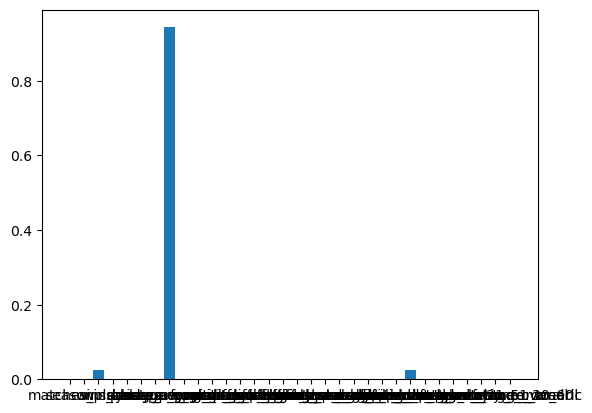

In [27]:
plt.bar(x=X_train.columns, height=model.feature_importances_)

In [28]:
teams_24 = pd.read_csv('spain-la-liga-teams-2023-to-2024-stats (2).csv')
teams_24

,team_name,common_name,season,country,matches_played,matches_played_home,matches_played_away,suspended_matches,wins,wins_home,wins_away,draws,draws_home,draws_away,losses,losses_home,losses_away,points_per_game,points_per_game_home,points_per_game_away,league_position,league_position_home,league_position_away,performance_rank,goals_scored,goals_conceded,goal_difference,total_goal_count,total_goal_count_home,total_goal_count_away,goals_scored_home,goals_scored_away,goals_conceded_home,goals_conceded_away,goal_difference_home,goal_difference_away,minutes_per_goal_scored,minutes_per_goal_scored_home,minutes_per_goal_scored_away,minutes_per_goal_conceded,minutes_per_goal_conceded_home,minutes_per_goal_conceded_away,clean_sheets,clean_sheets_home,clean_sheets_away,btts_count,btts_count_home,btts_count_away,fts_count,fts_count_home,fts_count_away,first_team_to_score_count,first_team_to_score_count_home,first_team_to_score_count_away,corners_total,corners_total_home,corners_total_away,cards_total,cards_total_home,cards_total_away,average_possession,average_possession_home,average_possession_away,shots,shots_home,shots_away,shots_on_target,shots_on_target_home,shots_on_target_away,shots_off_target,shots_off_target_home,shots_off_target_away,fouls,fouls_home,fouls_away,goals_scored_half_time,goals_scored_half_time_home,goals_scored_half_time_away,goals_conceded_half_time,goals_conceded_half_time_home,goals_conceded_half_time_away,goal_difference_half_time,goal_difference_half_time_home,goal_difference_half_time_away,leading_at_half_time,leading_at_half_time_home,leading_at_half_time_away,draw_at_half_time,draw_at_half_time_home,draw_at_half_time_away,losing_at_half_time,losing_at_half_time_home,losing_at_half_time_away,points_per_game_half_time,points_per_game_half_time_home,points_per_game_half_time_away,average_total_goals_per_match,average_total_goals_per_match_home,average_total_goals_per_match_away,goals_scored_per_match,goals_scored_per_match_home,goals_scored_per_match_away,goals_conceded_per_match,goals_conceded_per_match_home,goals_conceded_per_match_away,total_goals_per_match_half_time,total_goals_per_match_half_time_home,total_goals_per_match_half_time_away,goals_scored_per_match_half_time,goals_scored_per_match_half_time_home,goals_scored_per_match_half_time_away,goals_conceded_per_match_half_time,goals_conceded_per_match_half_time_home,goals_conceded_per_match_half_time_away,over05_count,over15_count,over25_count,over35_count,over45_count,over55_count,over05_count_home,over15_count_home,over25_count_home,over35_count_home,over45_count_home,over55_count_home,over05_count_away,over15_count_away,over25_count_away,over35_count_away,over45_count_away,over55_count_away,under05_count,under15_count,under25_count,under35_count,under45_count,under55_count,under05_count_home,under15_count_home,under25_count_home,under35_count_home,under45_count_home,under55_count_home,under05_count_away,under15_count_away,under25_count_away,under35_count_away,under45_count_away,under55_count_away,over05_percentage,over15_percentage,over25_percentage,over35_percentage,over45_percentage,over55_percentage,over05_percentage_home,over15_percentage_home,over25_percentage_home,over35_percentage_home,over45_percentage_home,over55_percentage_home,over05_percentage_away,over15_percentage_away,over25_percentage_away,over35_percentage_away,over45_percentage_away,over55_percentage_away,under05_percentage,under15_percentage,under25_percentage,under35_percentage,under45_percentage,under55_percentage,under05_percentage_home,under15_percentage_home,under25_percentage_home,under35_percentage_home,under45_percentage_home,under55_percentage_home,under05_percentage_away,under15_percentage_away,under25_percentage_away,under35_percentage_away,under45_percentage_away,under55_percentage_away,over05_count_half_time,over15_count_half_time,over25_count_half_time,over05_count_half_time_home,over15_count_half_time_home,over25_count_half_time_home,over05_count_half_time_away,over1

In [29]:
# Crear una lista con todos los DataFrames
dataframes = [teams_24]

# Ordenar cada DataFrame en función de 'league_position' en orden ascendente
for df in dataframes:
    df.sort_values(by='league_position', inplace=True)

# Verificar si están ordenados correctamente
for i, df in enumerate(dataframes, start=1):
    print(f"t_{i}_{i+1} sorted by league_position:\n", df[['team_name', 'league_position']])
    print()

t_1_2 sorted by league_position:
                        team_name  league_position
2                 Real Madrid CF                1
19                     Girona FC                2
1                   FC Barcelona                3
4        Club Atlético de Madrid                4
10          Athletic Club Bilbao                5
13       Real Sociedad de Fútbol                6
9            Real Betis Balompié                7
12                   Valencia CF                8
5                  UD Las Palmas                9
11                    CA Osasuna               10
0                  Villarreal CF               11
15         Getafe Club de Fútbol               12
6               Deportivo Alavés               13
3                     Sevilla FC               14
17  Real Club Deportivo Mallorca               15
14                Rayo Vallecano               16
7        Real Club Celta de Vigo               17
18                      Cádiz CF               18
8               

In [30]:
columns_to_drop = ['common_name', 'country']
for col in columns_to_drop:
    del teams_24[col]


In [31]:
teams_24['points'] = teams_24['wins'] * 3 + teams_24['draws']
teams_24['points_home'] = teams_24['wins_home'] * 3 + teams_24['draws_home']
teams_24['points_away'] = teams_24['wins_away'] * 3 + teams_24['draws_away']

columns = list(teams_24.columns)
columns.remove('points')
columns.remove('points_home')
columns.remove('points_away')

# Insertamos 'points' en la posición deseada
columns.insert(columns.index('wins'), 'points')
columns.insert(columns.index('wins'), 'points_home')
columns.insert(columns.index('wins'), 'points_away')

# Reasignamos las columnas al DataFrame
teams_24 = teams_24[columns]

print(teams_24)

                       team_name     season  matches_played  \
2                 Real Madrid CF  2023/2024              28   
19                     Girona FC  2023/2024              28   
1                   FC Barcelona  2023/2024              28   
4        Club Atlético de Madrid  2023/2024              28   
10          Athletic Club Bilbao  2023/2024              28   
13       Real Sociedad de Fútbol  2023/2024              28   
9            Real Betis Balompié  2023/2024              28   
12                   Valencia CF  2023/2024              27   
5                  UD Las Palmas  2023/2024              28   
11                    CA Osasuna  2023/2024              28   
0                  Villarreal CF  2023/2024              28   
15         Getafe Club de Fútbol  2023/2024              28   
6               Deportivo Alavés  2023/2024              28   
3                     Sevilla FC  2023/2024              28   
17  Real Club Deportivo Mallorca  2023/2024            

In [32]:
season_mapping = {'2023/2024': 2024}

# Aplicamos el mapeo a la columna 'season'
teams_24['season'] = teams_24['season'].map(season_mapping)

In [33]:
from sklearn.preprocessing import LabelEncoder

# Crea un nuevo LabelEncoder
label_encoder = LabelEncoder()

# Ajusta el LabelEncoder con los mismos valores que en teams_8_23
label_encoder.fit(teams_8_23['team_name'])

# Aplica el LabelEncoder a la columna 'team_name' en teams_24
teams_24['team_name_numeric'] = label_encoder.transform(teams_24['team_name'])

# Eliminamos las columnas no deseadas del DataFrame
teams_24.drop(['points_home', 'points_away', 'points_per_game_home', 
                 'points_per_game_away', 'suspended_matches', 'matches_played_home',
                 'matches_played_away'], axis=1, inplace=True)

columns_to_drop = [
    'first_team_to_score_percentage', 'goals_conceded_per_match_home', 'loss_percentage_home',
    'fouls_away', 'goals_scored_min_81_to_90', 'minutes_per_goal_scored_home', 'fts_percentage', 
    'clean_sheet_half_time_home', 'average_possession', 'goals_conceded_min_71_to_80', 'goals_scored', 
    'goals_conceded_min_81_to_90', 'loss_percentage_away', 'fts_count', 'goals_scored_per_match', 
    'xg_against_avg_overall', 'first_team_to_score_count_home', 'over115_corners_percentage', 
    'average_possession_home', 'corners_per_match_away', 'goals_scored_min_31_to_40', 'shots_off_target_away', 
    'goals_scored_min_71_to_80', 'over05_count_half_time', 'losses_home', 'goals_conceded_min_21_to_30', 
    'points_per_game_half_time_home', 'cards_total', 'over05_count', 'goals_scored_min_51_to_60', 
    'losing_at_half_time', 'goals_conceded_min_61_to_70', 'goals_conceded_per_match_half_time_home', 
    'clean_sheet_percentage', 'xg_against_avg_away', 'goals_scored_per_match_half_time', 'xg_against_avg_home', 
    'over65_corners_percentage', 'corners_total_away', 'goals_scored_min_61_to_70', 'btts_half_time_percentage_home', 
    'over15_count_half_time_home', 'total_goal_count_away', 'minutes_per_goal_conceded_away', 
    'goals_scored_per_match_half_time_home', 'draw_at_half_time_percentage_home', 'over45_percentage_home', 
    'goals_conceded', 'shots_home', 'clean_sheets_away', 'shots', 'draw_at_half_time_home', 'shots_on_target', 
    'average_possession_away', 'draw_percentage_away', 'league_position_home', 'goals_scored_half_time', 
    'losing_at_half_time_percentage', 'corners_total_home', 'under45_count_home', 'clean_sheets', 
    'over25_half_time_percentage_home', 'win_percentage_home', 'draw_at_half_time_away', 'fts_percentage_away', 
    'corners_per_match', 'btts_half_time_home', 'first_team_to_score_count', 'losing_at_half_time_percentage_away', 
    'points_per_game_half_time_away', 'cards_total_away', 'over35_count_home', 'home_advantage_percentage', 
    'over25_count_half_time_home', 'cards_per_match', 'corners_per_match_home', 'over105_corners_percentage', 
    'over05_percentage_home', 'goals_conceded_per_match_half_time_away', 'shots_off_target_home', 
    'first_team_to_score_percentage_away', 'losing_at_half_time_away', 'goals_conceded_away', 'over25_count', 
    'clean_sheets_home', 'goals_conceded_home', 'average_total_goals_per_match_away', 'shots_on_target_away', 
    'btts_count_home', 'goals_conceded_min_31_to_40', 'goals_conceded_half_time', 
    'goals_conceded_per_match_half_time', 'shots_away', 'cards_total_home', 'under15_percentage_home', 'fouls', 
    'over25_percentage_home', 'over125_corners_percentage', 'fts_half_time_home', 'leading_at_half_time_percentage', 
    'leading_at_half_time', 'clean_sheet_half_time_percentage', 'btts_half_time_away', 'over05_percentage', 
    'under25_percentage_away', 'clean_sheet_half_time_percentage_home', 'goals_scored_min_41_to_50', 
    'under05_percentage', 'over75_corners_percentage', 'xg_for_avg_away', 'btts_percentage_away', 
    'over135_corners_percentage', 'over85_corners_percentage', 'under15_count_home', 'fts_half_time_percentage_home', 
    'over95_corners_percentage', 'under25_percentage_home', 'corners_total', 'over15_count_home', 
    'goals_conceded_min_11_to_20', 'clean_sheet_half_time_percentage_away', 'goal_difference_half_time_away', 
    'goals_conceded_per_match_away', 'fts_half_time_away', 'btts_percentage', 'under05_percentage_home', 
    'prediction_risk', 'goals_scored_half_time_home', 'over05_count_home', 'under35_percentage_away', 
    'under35_count_home', 'btts_half_time', 'over35_count_away', 'over15_percentage_away', 'shots_on_target_home', 
    'shots_off_target', 'clean_sheet_half_time_away', 'over45_percentage', 'under45_count', 'over25_count_half_time', 
    'over25_percentage_away', 'cards_per_match_home', 'btts_half_time_percentage', 'goals_conceded_min_41_to_50', 
    'under55_percentage_away', 'xg_for_avg_home', 'under15_percentage', 'total_goals_per_match_half_time_away', 
    'over15_half_time_percentage', 'goals_conceded_half_time_home', 'over45_count_away', 'wins_home', 
    'leading_at_half_time_percentage_home', 'under15_count_away', 'over25_half_time_percentage', 'fts_count_home', 
    'leading_at_half_time_percentage_away', 'clean_sheet_percentage_away', 'leading_at_half_time_percentage_away', 
    'goals_scored_min_11_to_20', 'over35_percentage_home', 'over05_half_time_percentage_away', 'draws_home', 
    'losing_at_half_time_home', 'over15_half_time_percentage_home', 'goals_scored_per_match_home', 
    'average_total_goals_per_match_home', 'total_goals_per_match_half_time', 'btts_percentage_home', 
    'draw_at_half_time', 'goals_conceded_min_0_to_10', 'over25_half_time_percentage_away', 'cards_per_match_away', 
    'fts_count_away', 'over55_count', 'btts_count', 'first_team_to_score_count_away', 'clean_sheet_percentage_home', 
    'fts_half_time_percentage', 'minutes_per_goal_conceded', 'over145_corners_percentage', 'fts_half_time_percentage_away', 
    'xg_for_avg_overall', 'goals_scored_per_match_half_time_away', 'over15_count', 'under25_count', 
    'goals_scored_min_0_to_10', 'over05_count_half_time_home', 'under15_count', 'under35_percentage', 
    'over05_half_time_percentage', 'under55_percentage_home', 'total_goals_per_match_half_time_home', 
    'under55_count', 'over35_percentage_away', 'over25_count_home', 'draw_percentage_home', 'under15_percentage_away', 
    'leading_at_half_time_home', 'under05_count_home', 'fts_percentage_home', 'over05_half_time_percentage_home', 
    'first_team_to_score_percentage_home', 'under35_count', 'btts_count_away', 'draw_at_half_time_percentage_away', 
    'over15_count_half_time_away', 'under45_percentage_away', 'total_goal_count_home', 'over05_count_half_time_away', 
    'draw_at_half_time_percentage', 'under45_percentage_home', 'over35_percentage', 'over45_percentage_away', 
    'over15_count_half_time', 'over25_percentage', 'btts_half_time_percentage_away', 'over15_half_time_percentage_away', 
    'over55_percentage', 'under25_percentage', 'under35_count_away', 'over35_count', 'minutes_per_goal_conceded_home', 
    'over55_percentage_away', 'under55_count_home', 'under55_count_away', 'goals_conceded_half_time_away', 
    'over25_count_half_time_away', 'draws_away', 'fts_half_time', 'over45_count_home', 'under55_percentage', 
    'over15_percentage_home', 'over15_count_away', 'goals_scored_half_time_away', 'over15_percentage', 
    'under25_count_home', 'under35_percentage_home', 'under25_count_away', 'total_goal_count', 'over25_count_away', 
    'under45_count_away', 'minutes_per_goal_scored', 'over45_count', 'over05_count_away', 'average_total_goals_per_match', 
    'under05_count', 'over55_percentage_home', 'over55_count_away', 'under45_percentage', 
    'losing_at_half_time_percentage_home', 'over55_count_home', 'under05_percentage_away', 'over05_percentage_away', 
    'under05_count_away'
]

teams_24.drop(columns_to_drop, axis=1, inplace=True)


In [34]:
X_train2 = teams_8_23.drop(columns=['points', 'team_name'])
X_test2 = teams_24.drop(columns=['points', 'team_name'])
y_train2 = teams_8_23.points

In [35]:
X_test2

,season,matches_played,wins,wins_away,draws,losses,losses_away,points_per_game,league_position,league_position_away,performance_rank,goal_difference,goals_scored_home,goals_scored_away,goal_difference_home,goal_difference_away,minutes_per_goal_scored_away,fouls_home,goal_difference_half_time,goal_difference_half_time_home,leading_at_half_time_away,points_per_game_half_time,goals_scored_per_match_away,goals_conceded_per_match,win_percentage,win_percentage_away,clean_sheet_half_time,goals_scored_min_21_to_30,goals_conceded_min_51_to_60,draw_percentage_overall,loss_percentage_ovearll,team_name_numeric
2,2024,28,21,9,6,1,1,2.46,1,1,1,42,35,25,28,14,50,138,10,7,4,1.64,1.79,0.64,75,64,20,5,2,21,4,23
19,2024,28,19,8,5,4,3,2.21,2,3,2,26,35,24,21,5,53,148,10,9,4,1.61,1.71,1.18,68,57,15,4,6,18,14,12
1,2024,28,18,7,7,3,0,2.18,3,2,3,23,33,24,14,9,49,168,1,1,4,1.29,1.85,1.21,64,54,17,4,5,25,11,10
4,2024,28,17,4,4,7,7,1.96,4,8,4,23,34,20,21,2,63,138,10,12,3,1.61,1.43,1.11,61,29,17,4,4,14,25,5
10,2024,28,15,5,8,5,4,1.89,5,5,5,22,34,14,20,2,90,194,15,8,6,1.89,1.00,0.93,54,36,23,6,3,29,18,0
13,2024,28,11,6,10,7,4,1.54,6,4,6,9,19,21,4,5,64,195,5,4,4,1.43,1.40,1.11,39,40,18,3,2,36,25,25
9,2024,28,10,3,12,6,4,1.50,7,9,7,3,21,13,8,-5,90,167,1,3,3,1.43,1.00,1.11,36,23,16,1,1,43,21,18
12,2024,27,11,3,7,9,7,1.48,8,12,8,1,18,14,10,-9,83,163,4,9,1,1.33,1.08,1.15,41,23,17,5,4,26,33,35
5,2024,28,10,4,7,11,7,1.32,9,11,9,-2,17,12,5,-7,105,155,1,4,4,1.43,0.86,1.11,36,29,22,2,2,25,39,34
11,2024,28,10,4,6,12,7,1.29,10,10,10,-8,15,16,-2,-6,79,196,-4,-2,3,1.11,1.14,1.39,36,29,15,4,5,21,43,1


In [36]:
# Paso 2: Evaluar el modelo
model.fit(X_train2, y_train2)

RandomForestRegressor(random_state=42)

In [37]:
y2_pred= model.predict(X_test2)
y2_pred

array([90.84, 82.89, 81.03, 75.42, 71.25, 58.03, 56.68, 55.93, 50.02,
       48.96, 47.05, 47.06, 43.  , 37.93, 36.01, 34.84, 32.62, 30.04,
       23.78, 23.34])

In [38]:
import pandas as pd

# Lista de valores de puntos esperados
expected_points_data = [90.84, 82.89, 81.03, 75.42, 71.25, 58.03, 56.68, 55.93, 50.02,
       48.96, 47.05, 47.06, 43., 37.93, 36.01, 34.84, 32.62, 30.04,
       23.78, 23.34]

# Crear el DataFrame con la columna 'expected_points'
expected_points_df = pd.DataFrame({'expected_points': expected_points_data})

# Mostrar el DataFrame
print(expected_points_df)


    expected_points
0             90.84
1             82.89
2             81.03
3             75.42
4             71.25
5             58.03
6             56.68
7             55.93
8             50.02
9             48.96
10            47.05
11            47.06
12            43.00
13            37.93
14            36.01
15            34.84
16            32.62
17            30.04
18            23.78
19            23.34


In [39]:
y_test2 = teams_24['points']
y_test2

2     69
19    62
1     61
4     55
10    53
13    43
9     42
12    40
5     37
11    36
0     35
15    35
6     32
3     28
17    27
14    26
7     24
18    22
8     14
16    10
Name: points, dtype: int64

In [40]:
dictio_images = {'Real Madrid CF': 'https://cdn.ssref.net/req/202312151/tlogo/fb/53a2f082.png',
'Girona FC': 'https://cdn.ssref.net/req/202312151/tlogo/fb/9024a00a.png',
'FC Barcelona': 'https://cdn.ssref.net/req/202312151/tlogo/fb/206d90db.png',
'Club Atlético de Madrid':'https://cdn.ssref.net/req/202312151/tlogo/fb/db3b9613.png',
'Athletic Club Bilbao': 'https://cdn.ssref.net/req/202312151/tlogo/fb/2b390eca.png',
'Real Sociedad de Fútbol': 'https://cdn.ssref.net/req/202312151/tlogo/fb/e31d1cd9.png',
'Real Betis Balompié': 'https://cdn.ssref.net/req/202312151/tlogo/fb/fc536746.png',
'Valencia CF': 'https://cdn.ssref.net/req/202312151/tlogo/fb/dcc91a7b.png',
'UD Las Palmas': 'https://cdn.ssref.net/req/202312151/tlogo/fb/0049d422.png',
'CA Osasuna': 'https://cdn.ssref.net/req/202312151/tlogo/fb/03c57e2b.png', 
'Villarreal CF': 'https://cdn.ssref.net/req/202312151/tlogo/fb/2a8183b3.png',
'Getafe Club de Fútbol': 'https://cdn.ssref.net/req/202312151/tlogo/fb/7848bd64.png', 
'Deportivo Alavés': 'https://cdn.ssref.net/req/202312151/tlogo/fb/8d6fd021.png', 
'Sevilla FC': 'https://cdn.ssref.net/req/202312151/tlogo/fb/ad2be733.png',
'Real Club Deportivo Mallorca': 'https://cdn.ssref.net/req/202312151/tlogo/fb/2aa12281.png', 
'Rayo Vallecano': 'https://cdn.ssref.net/req/202312151/tlogo/fb/98e8af82.png',
'Real Club Celta de Vigo': 'https://cdn.ssref.net/req/202312151/tlogo/fb/f25da7fb.png', 
'Cádiz CF': 'https://cdn.ssref.net/req/202312151/tlogo/fb/ee7c297c.png', 
'Granada CF': 'https://cdn.ssref.net/req/202312151/tlogo/fb/a0435291.png', 
'UD Almería': 'https://cdn.ssref.net/req/202312151/tlogo/fb/78ecf4bb.png'}

In [41]:
LaLiga_Classification = pd.read_csv('LaLiga_Classification.csv')

# Lista de valores de puntos esperados
expected_points_data = [90.84, 82.89, 81.03, 75.42, 71.25, 58.03, 56.68, 55.93, 50.02,
       48.96, 47.05, 47.06, 43., 37.93, 36.01, 34.84, 32.62, 30.04, 23.78, 23.34]

# Crear el DataFrame con la columna 'expected_points'
expected_points_df = pd.DataFrame({'expected_points': expected_points_data})

# Convertir los valores de punto flotante a enteros
expected_points_df['expected_points'] = expected_points_df['expected_points'].astype(int)

# Concatenar los DataFrames
LaLiga_Classification_final = pd.concat([LaLiga_Classification, expected_points_df], axis=1)

In [45]:
LaLiga_Classification_final = LaLiga_Classification_final.rename(columns={'team_name': 'actual_classification'})
LaLiga_Classification_final.index = range(1, len(LaLiga_Classification_final) + 1)
LaLiga_Classification_final['Image_URL'] = LaLiga_Classification_final['actual_classification'].map(dictio_images)
LaLiga_Classification_final

,actual_classification,matches_played,wins,draws,losses,goals_scored,goals_conceded,goal_difference,total_goal_count,points,points_per_game,expected_points,Image_URL
1,Real Madrid CF,28,21,6,1,60,18,42,78,69,2.46,90,https://cdn.ssref.net/req/202312151/tlogo/fb/5...
2,Girona FC,28,19,5,4,59,33,26,92,62,2.21,82,https://cdn.ssref.net/req/202312151/tlogo/fb/9...
3,FC Barcelona,28,18,7,3,57,34,23,91,61,2.18,81,https://cdn.ssref.net/req/202312151/tlogo/fb/2...
4,Club Atlético de Madrid,28,17,4,7,54,31,23,85,55,1.96,75,https://cdn.ssref.net/req/202312151/tlogo/fb/d...
5,Athletic Club Bilbao,28,15,8,5,48,26,22,74,53,1.89,71,https://cdn.ssref.net/req/202312151/tlogo/fb/2...
6,Real Sociedad de Fútbol,28,11,10,7,40,31,9,71,43,1.54,58,https://cdn.ssref.net/req/202312151/tlogo/fb/e...
7,Real Betis Balompié,28,10,12,6,34,31,3,65,42,1.50,56,https://cdn.ssref.net/req/202312151/tlogo/fb/f...
8,Valencia CF,27,11,7,9,32,31,1,63,40,1.48,55,https://cdn.ssref.net/req/202312151/tlogo/fb/d...
9,UD Las Palmas,28,10,7,11,29,31,-2,60,37,1.32,50,https://cdn.ssref.net/req/202312151/tlogo/fb/0...
10,CA Osasuna,28,10,6,12,31,39,-8,70,36,1.29,48,https://cdn.ssref.net/req/202312151/tlogo/fb/0...


In [43]:
LaLiga_Classification_final['actual_classification'].unique()

array(['Real Madrid CF', 'Girona FC', 'FC Barcelona',
       'Club Atlético de Madrid', 'Athletic Club Bilbao',
       'Real Sociedad de Fútbol', 'Real Betis Balompié', 'Valencia CF',
       'UD Las Palmas', 'CA Osasuna', 'Villarreal CF',
       'Getafe Club de Fútbol', 'Deportivo Alavés', 'Sevilla FC',
       'Real Club Deportivo Mallorca', 'Rayo Vallecano',
       'Real Club Celta de Vigo', 'Cádiz CF', 'Granada CF', 'UD Almería'],
      dtype=object)

In [46]:
LaLiga_Classification_final.to_csv('LaLiga_Classification_final.csv', index=False)